### Загружаем библиотеки

In [1]:
import numpy as np
import pandas as pd
import scipy
import h3

from tqdm import tqdm
from sklearn.metrics import mean_absolute_error, r2_score
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline 

In [2]:
import warnings
warnings.filterwarnings('ignore')

### Загружаем данные

In [3]:
df = pd.read_csv('train.csv')
df

,geo_h3_10,lat_10,lon_10,feat_0,feat_1,feat_2,feat_3,feat_4,feat_5,feat_6,...,feat_97,feat_98,feat_99,feat_100,feat_101,feat_102,feat_103,feat_104,dt,pred
0,8a1181b2ba2ffff,55.503834,37.576614,634.24390,817.54675,759.8750,684.31370,127483.02,58045.82,6079.00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,452.30276,20210401,5943.575327
1,8a1181b66ad7fff,55.577595,37.597054,353.37833,409.18585,613.1053,416.73734,31804.05,31507.31,19619.37,...,NaN,NaN,624.62840,NaN,NaN,NaN,NaN,624.62840,20210401,4784.871945
2,8a1181b68d9ffff,55.615330,37.682785,570.00000,593.75000,704.2105,617.27270,13110.00,14250.00,13380.00,...,NaN,1174.89700,NaN,NaN,NaN,NaN,NaN,1174.89700,20210401,4615.358099
3,8a1181b6c6a7fff,55.619507,37.671840,935.88890,1520.92590,1482.6666,1253.83340,25269.00,41065.00,8896.00,...,NaN,NaN,NaN,NaN,NaN,1849.403,NaN,1849.40300,20210401,5513.642395
4,8a11aa01820ffff,55.981903,37.249943,1365.97570,1044.59690,1398.0240,1236.73950,382473.22,269506.00,116036.00,...,NaN,NaN,449.06183,NaN,NaN,NaN,NaN,390.13397,20210401,4895.743837
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
126043,8a11aa7aba5ffff,55.771763,37.637170,2945.96480,2223.68700,3683.3843,2920.21830,427164.90,364684.70,534090.75,...,NaN,1265.90210,3292.93120,NaN,NaN,NaN,10310.282,1402.60910,20210201,6694.676943
126044,8a11aa7b17a7fff,55.683357,37.552513,568.30255,542.52420,911.7054,736.12270,110819.00,145939.00,439442.00,...,NaN,370.58954,NaN,2238.6643,NaN,NaN,NaN,316.59720,20210201,5962.962424
126045,8a11aa7b2b17fff,55.658750,37.531060,6384.90700,7875.83200,8827.2110,7567.58200,893887.00,1433401.40,794449.00,...,NaN,NaN,2224.20700,NaN,NaN,NaN,NaN,346.92245,20210201,5134.592897
126046,8a11aa7b56c7fff,55.687786,37.527040,1718.75000,3530.00000,3111.8750,2907.05880,13750.00,35300.00,49790.00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3744.96920,20210201,5427.317144


### Проанализируем данные

In [4]:
pd.set_option('display.max_rows', 110)
(100 * df.isna().sum() / df.shape[0])

geo_h3_10     0.000000
lat_10        0.000000
lon_10        0.000000
feat_0        1.055154
feat_1        1.324099
feat_2        4.325336
feat_3        0.000000
feat_4        1.055154
feat_5        1.324099
feat_6        4.325336
feat_7        0.000000
feat_8        0.000000
feat_9        0.000000
feat_10       0.000000
feat_11       0.000000
feat_12       0.000000
feat_13       0.000000
feat_14       0.000000
feat_15       1.055154
feat_16       1.324099
feat_17       4.325336
feat_18      90.892358
feat_19      90.922506
feat_20      91.338220
feat_21      90.663874
feat_22      90.892358
feat_23      90.922506
feat_24      91.338220
feat_25      71.944815
feat_26      71.783765
feat_27      72.786558
feat_28      71.101485
feat_29      71.944815
feat_30      71.783765
feat_31      72.786558
feat_32      52.568863
feat_33      52.853675
feat_34      54.457032
feat_35      52.284844
feat_36      52.568863
feat_37      52.853675
feat_38      54.457032
feat_39      83.333333
feat_40    

В некоторых признаках пустых значений слишком много. Многие из них имеют пустые значения почти во всех полях. Обработаем их чуть позже.

Найдем коэффициенты корреляции между признаками и целевой переменной.

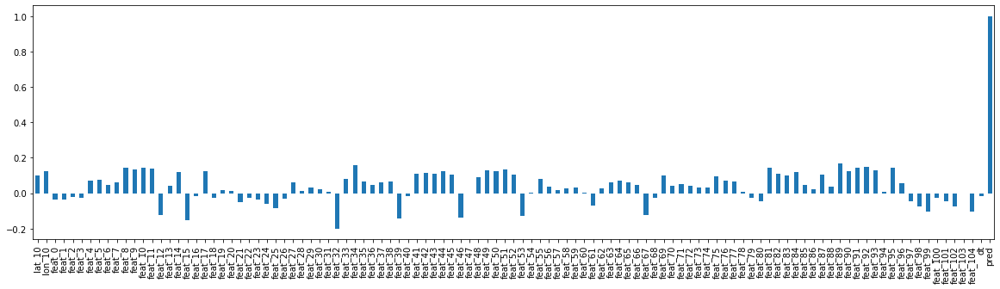

In [5]:
df.corrwith(df["pred"]).plot.bar(figsize=(20, 5))

Целевая переменная плохо коррелирует с признаками.

Чтобы подробнее проанализировать зависимости, посмотрим на диаграммы рассеяния между признаками и целевой переменной.

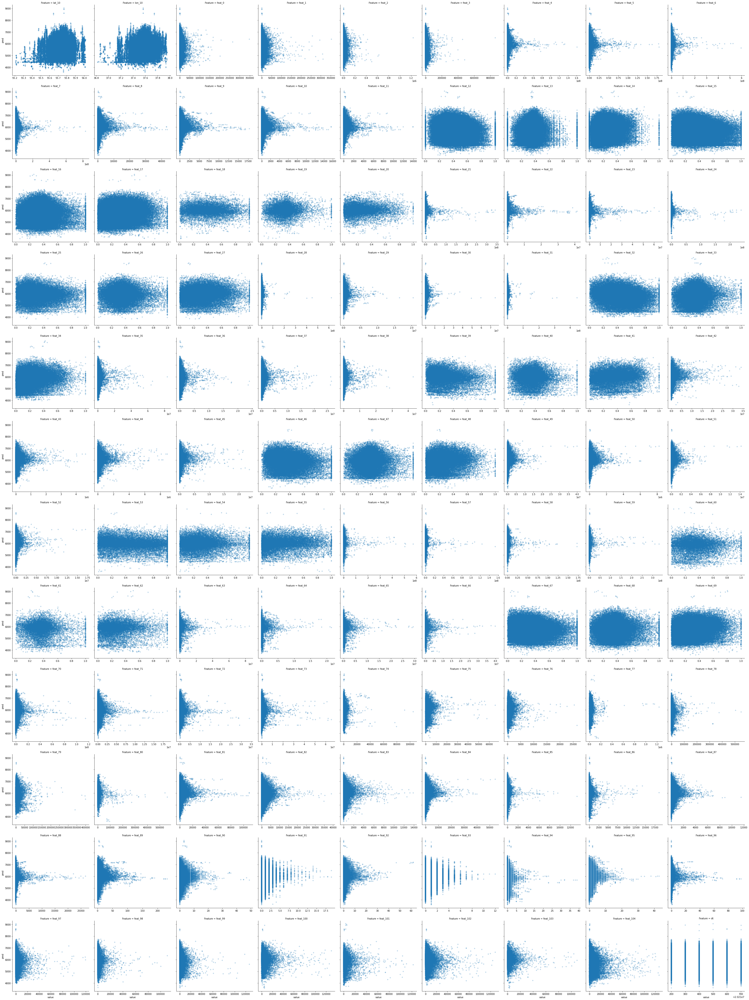

In [6]:
sns.relplot(
    data=df.melt(id_vars='pred', value_vars=df.columns[1:-1], var_name='Feature'),
    x='value', y='pred', kind='scatter', height=5, col='Feature', col_wrap=9, facet_kws={'sharex': False}, marker='+'
)

Судя по графикам, во многих признаках есть большое количество выбросов.

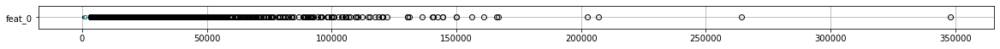

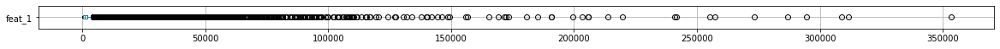

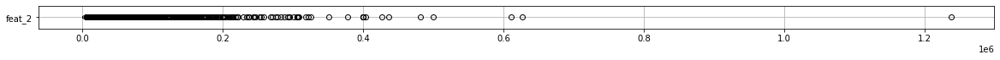

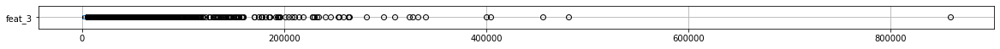

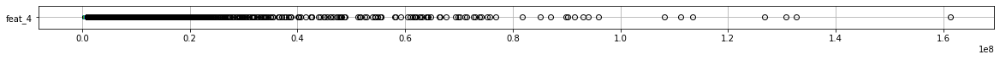

...

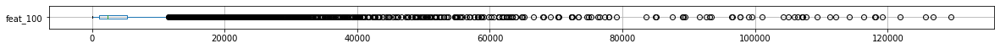

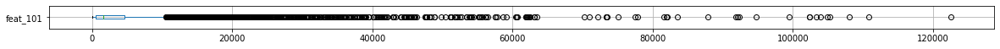

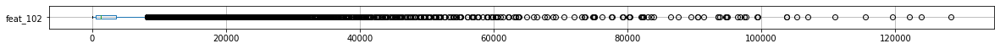

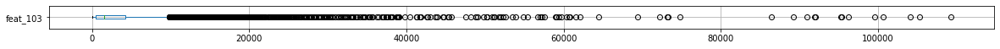

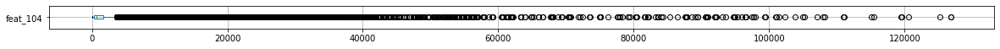

In [7]:
for col in df.columns[3:-2]:
    plt.figure(figsize=(20, 0.5))
    df[[col]].boxplot(vert=False)

Ящичковая диаграмма показывает, что в данных, действительно, очень много выбросов.

### Обработаем выбросы и пустые значения

Кажется, что гексагоны, находящиеся рядом друг с другом должны обладать похожими характеристиками, поэтому возникла идея сгладить значения в гексагонах медианным значением их ближайших соседей (несколько "колец" вокруг исходного гексагона). В таком случае мы сгладим выбросы и сможем заполнить некоторые пропущенные значения.

In [8]:
def median_smoothing(col, df, k=2):
    data = df[['geo_h3_10', col]]
    initial = dict(zip(list(data.groupby('geo_h3_10')[col].mean().index), list(data.groupby('geo_h3_10')[col].mean())))
    ms = {}
    for h in initial:
        ms[h] = np.nanmedian(list(map(lambda x: initial[x] if x in initial else np.nan, h3.k_ring(h, k=k))))
    return data['geo_h3_10'].apply(lambda x: ms[x])


# dfms = df.copy()
# for col in tqdm(df.columns[3:-2]):
#     for dt in dfms['dt'].unique():
#         index = dfms[dfms['dt'] == dt].index
#         dfms[col].loc[index] = median_smoothing(col, dfms.loc[index], k=3)

dfms = df.copy()
for col in tqdm(df.columns[3:-2]):
    dfms[col] = median_smoothing(col, dfms, k=3)

100%|██████████| 105/105 [06:21<00:00,  3.63s/it]


In [9]:
(100 * dfms.isna().sum() / dfms.shape[0])

geo_h3_10     0.000000
lat_10        0.000000
lon_10        0.000000
feat_0        0.005553
feat_1        0.000000
feat_2        0.013487
feat_3        0.000000
feat_4        0.005553
feat_5        0.000000
feat_6        0.013487
feat_7        0.000000
feat_8        0.000000
feat_9        0.000000
feat_10       0.000000
feat_11       0.000000
feat_12       0.000000
feat_13       0.000000
feat_14       0.000000
feat_15       0.005553
feat_16       0.000000
feat_17       0.013487
feat_18      33.997366
feat_19      33.899784
feat_20      35.109641
feat_21      33.430915
feat_22      33.997366
feat_23      33.899784
feat_24      35.109641
feat_25       7.769263
feat_26       7.727215
feat_27       8.119923
feat_28       7.514598
feat_29       7.769263
feat_30       7.727215
feat_31       8.119923
feat_32       2.594250
feat_33       2.593456
feat_34       2.756886
feat_35       2.575209
feat_36       2.594250
feat_37       2.593456
feat_38       2.756886
feat_39      17.939991
feat_40    

Пустых значений стало меньше.

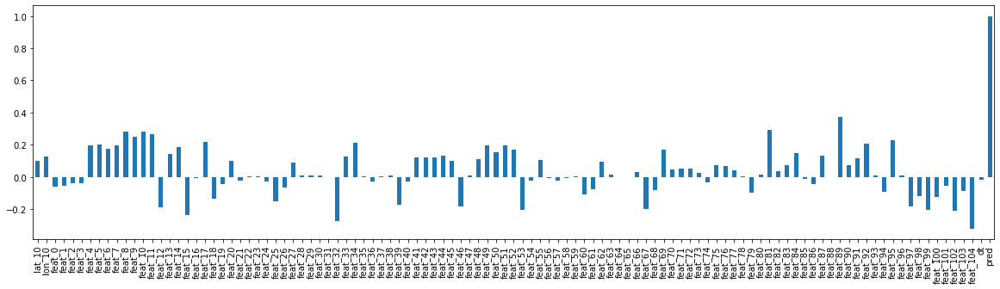

In [10]:
dfms.corrwith(dfms["pred"]).plot.bar(figsize=(20, 5))

После обработки многие из признаков стали значительно сильнее коррелировать с целевой переменной.

Оставшиеся пустые значения заменим на среднее.

In [11]:
dfms.iloc[:, 3:-2] = dfms.iloc[:, 3:-2].fillna(dfms.iloc[:, 3:-2].mean())

### Построим модель

Для начала построим линейную регрессию.

In [12]:
X_train, X_test, y_train, y_test = train_test_split(dfms.iloc[:, 3:-2], dfms['pred'], random_state=1234)

linear1 = LinearRegression().fit(X_train, y_train)
print("MAE = %.4f" % mean_absolute_error(y_test, linear1.predict(X_test)))

MAE = 397.7625


In [13]:
r2_score(y_test, linear1.predict(X_test))

0.29541720401966254

Признаки для линейной регрессии можно отобрать, оценив уровень значимости параметров линейной модели.

In [14]:
from sklearn.feature_selection import f_regression

f, p = f_regression(X_train, y_train)

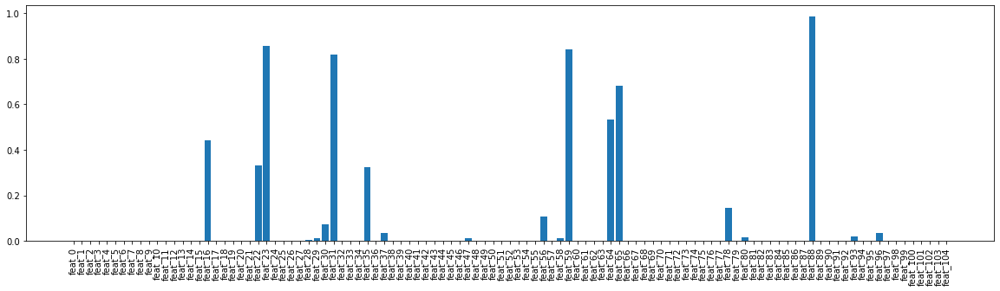

In [15]:
plt.figure(figsize=(20, 5))
plt.bar(dfms.columns[3:-2], p)
plt.xticks(rotation=90)
plt.show()

Заметим большое значение p-value имеют как раз те признаки, у которых была самая маленькая корреляция с целевой переменной.

Оставим только те признаки, уровень значимости которых меньше 0.01.

In [16]:
best_features = np.array(dfms.columns[3:-2])[p < 0.01]

In [17]:
linear2 = LinearRegression().fit(X_train[best_features], y_train)
print("MAE = %.4f" % mean_absolute_error(y_test, linear2.predict(X_test[best_features])))

MAE = 399.1671


In [18]:
r2_score(y_test, linear2.predict(X_test[best_features]))

0.28908567860158285

Линейная модель показывает плохое качество. Видимо, в данных имеются сложные нелинейные зависимости.

Попробуем построить случайный лес.

In [19]:
%%time
forest1 = RandomForestRegressor(max_depth=1000, n_estimators=20).fit(X_train, y_train)
print("MAE = %.4f" % mean_absolute_error(y_test, forest1.predict(X_test)))

MAE = 88.5716
CPU times: user 2min 15s, sys: 310 ms, total: 2min 16s
Wall time: 2min 23s


In [20]:
r2_score(y_test, forest1.predict(X_test))

0.9432383036797221

Случайный лес показал достаточно хорошее качество. Коэффициент детерминации $R^2$ близок к 1.

Древесные алгоритмы устроены так, что сами отбирают наиболее важные признаки.

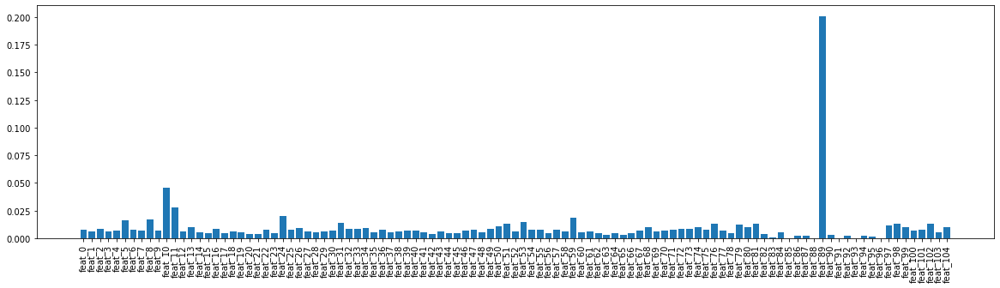

In [21]:
plt.figure(figsize=(20, 5))
plt.bar(dfms.columns[3:-2], forest1.feature_importances_)
plt.xticks(rotation=90)
plt.show()

Оставим признаки, важность которых больше 0.01.

In [22]:
best_features = np.array(dfms.columns[3:-2])[forest1.feature_importances_ > 0.01]

In [23]:
%%time
forest2 = RandomForestRegressor(max_depth=1000, n_estimators=20).fit(X_train[best_features], y_train)
print("MAE = %.4f" % mean_absolute_error(y_test, forest2.predict(X_test[best_features])))

MAE = 89.5430
CPU times: user 28.6 s, sys: 62.4 ms, total: 28.7 s
Wall time: 29.1 s


In [24]:
r2_score(y_test, forest2.predict(X_test[best_features]))

0.9408543932971346

Теперь модель работает гораздо быстрее, почти не теряя в качестве.

### Применим модель к тестовым данным

In [25]:
df_test = pd.read_csv('test.csv')

dftt = df.append(df_test, ignore_index=True)[['geo_h3_10', 'lat_10', 'lon_10'] + list(best_features) + ['dt', 'pred']]
border = len(df)

In [26]:
# dfms = dftt.copy()
# for col in tqdm(dftt.columns[3:-2]):
#     for dt in dfms['dt'].unique():
#         index = dfms[dfms['dt'] == dt].index
#         dfms[col].loc[index] = median_smoothing(col, dfms.loc[index], k=3)

dfms = dftt.copy()
for col in tqdm(dftt.columns[3:-2]):
    dfms[col] = median_smoothing(col, dfms, k=3)

100%|██████████| 21/21 [01:23<00:00,  3.99s/it]


In [27]:
dfms.iloc[:, 3:-2] = dfms.iloc[:, 3:-2].fillna(dfms.iloc[:, 3:-2].mean())

In [28]:
X_train, X_test, y_train = dfms.iloc[:border, 3:-2], dfms.iloc[border:, 3:-2], dfms.iloc[:border, -1]

forest = RandomForestRegressor(max_depth=1000, n_estimators=20).fit(X_train, y_train)
df_test['pred'] = forest.predict(X_test)

In [29]:
df_test.to_csv('result.csv', index=False) 

### Визуализируем на карте

In [30]:
from google.colab import output
output.enable_custom_widget_manager()

In [31]:
from keplergl import KeplerGl

map = KeplerGl(height=700)
map.add_data(data=df[['geo_h3_10', 'pred']], name='1') 
map

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(data={'1': {'index': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 2…

In [ ]:
from google.colab import output
output.disable_custom_widget_manager()